In [2]:
import pandas as pd
import plotly.express as px
from sklearn.preprocessing import StandardScaler

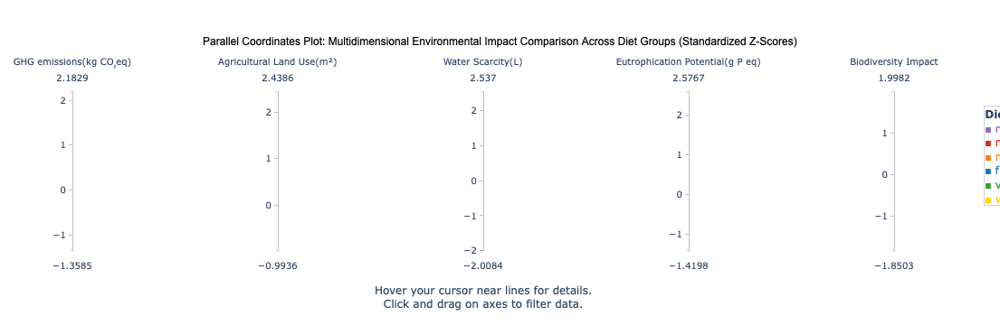

In [14]:
##########################   Parallel Coordinates Plot: Multidimensional Environmental Impact Comparison Across Diet Groups (Standardized Z-Scores)   ######################################

# 读取数据
df = pd.read_csv("Results_21Mar2022.csv")   #7200=6*6*2*100
df[['diet', 'sex', 'age']] = df['grouping'].str.split('_', expand=True)

#########################2. 可视化前的数据预处理
#2.1聚合数据(按grouping分组计算均值)
df_agg = df.groupby('grouping').agg({
    'mean_ghgs': 'mean',
    'mean_land': 'mean',
    'mean_watscar': 'mean',
    'mean_eut': 'mean',
    'mean_bio': 'mean'
}).reset_index()       #df_agg含grouping column 无 diet等

#拆分grouping列
df_agg[['diet', 'sex', 'age']] = df_agg['grouping'].str.split('_', expand=True)

# 数据标准化
scaler = StandardScaler()
df_agg[['mean_ghgs', 'mean_land', 'mean_watscar', 'mean_eut', 'mean_bio']] = scaler.fit_transform(
    df_agg[['mean_ghgs', 'mean_land', 'mean_watscar', 'mean_eut', 'mean_bio']]
)

# 颜色映射
diet_order = ["fish", "meat <50", "meat 100+", "meat50-99", "vegan", "veggie"]
diet_colorscale = [
    [0, "#1f77b4"],  # fish
    [0.2, "#ff7f0e"],  # meat <50
    [0.4, "#9467bd"],  # meat 100+
    [0.6, "#d62728"],  # meat50-99
    [0.8, "#2ca02c"],  # vegan
    [1.0, "#FFD700"]   # veggie #8c564b：brown
]

# 将 diet 映射为数值
diet_mapping = {diet: i for i, diet in enumerate(diet_order)}
df_agg["diet_numeric"] = df_agg["diet"].map(diet_mapping)

# 画平行坐标图
fig = px.parallel_coordinates(
    df_agg,
    dimensions=['mean_ghgs', 'mean_land', 'mean_watscar', 'mean_eut', 'mean_bio'],
    
    color='diet_numeric',  # 用数值代替字符串分类   
    color_continuous_scale=diet_colorscale,  # 使用离散色阶   
    #color=df_agg['diet'].astype('category').cat.codes,  # 数值编码
    
    labels={
        'mean_ghgs': "GHG emissions(kg CO₂eq)", 
        'mean_land': "Agricultural Land Use(m²)",
        'mean_watscar': "Water Scarcity(L)", 
        'mean_eut': "Eutrophication Potential(g P eq)",
        'mean_bio': "Biodiversity Impact",
        'diet_numeric': "Diet Group"
    },
    title="Parallel Coordinates Plot: Multidimensional Environmental Impact Comparison Across Diet Groups (Standardized Z-Scores)",
)

'''
# 旋转所有维度标签（45度倾斜）
for i, dim in enumerate(fig.data[0].dimensions, start=1):
        fig.update_layout(
            {f"xaxis{i}": dict(tickangle=45, tickfont=dict(size=12))}  # 同时调整字体大小
    )
'''

# 关闭默认颜色条
fig.update_layout(coloraxis_showscale=False, margin=dict(r=117),title_font=dict(family="Arial", size=12, color="black"),title_x=0.5) # 为图例留出空间

# 调整图例
fig.add_annotation(
    x=1.2, y=0.6,  # 位置 (x 轴越大越靠右, y 轴越大越靠上)
    xref="paper", yref="paper",
    text="<b>Diet Groups</b><br>"
         "<span style='color:#9467bd'>■ meat100+</span><br>"
         "<span style='color:#d62728'>■ meat50-99</span><br>"
         "<span style='color:#ff7f0e'>■ meat<50</span><br>"
         "<span style='color:#1f77b4'>■ fish</span><br>"
         "<span style='color:#2ca02c'>■ vegan</span><br>"
         "<span style='color:#FFD700'>■ veggie</span>",
    showarrow=False,
    align="left",
    font=dict(size=12),
    bgcolor="white",
    bordercolor="gray",
    borderwidth=0.5
)

# 添加底部提示文本注释
fig.add_annotation(
    text="Hover your cursor near lines for details.<br>Click and drag on axes to filter data.",
    showarrow=False,
    xref="paper", yref="paper",
    x=0.5, y=-0.36
)

fig.show()

In [15]:
#保存高清图片：
#fig.write_image("/Users/mac/Downloads/Sprng_Smstr/RM/crswrk_2/Prlll_Crdnts_3.svg", scale=1)
#fig.write_image("./Prlll_Crdnts_0.png", scale=1, width=1200, height=800)  # 保存到当前目录下的文件夹

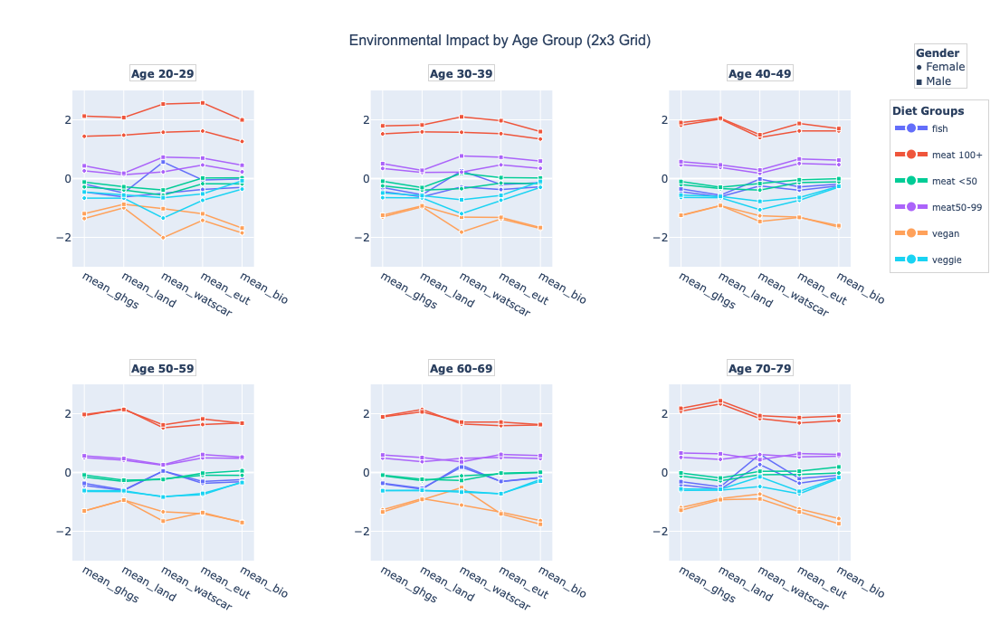

In [7]:
#################   Environmental Impact by Age Groups (2x3 Grid)   ################# 

#import pandas as pd
#from sklearn.preprocessing import StandardScaler
#import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
#import matplotlib.pyplot as plt

'''df = pd.read_csv("Results_21Mar2022.csv") 

df_agg = df.groupby('grouping').agg({
    'mean_ghgs': 'mean',
    'mean_land': 'mean',
    'mean_watscar': 'mean',
    'mean_eut': 'mean',
    'mean_bio': 'mean'
}).reset_index()

df_agg[['diet', 'sex', 'age']] = df_agg['grouping'].str.split('_', expand=True)
'''

# 数据标准化
scaler = StandardScaler()
df_agg[['ghgs_norm', 'land_norm', 'watscar_norm', 'eut_norm', 'bio_norm']] = scaler.fit_transform(
    df_agg[['mean_ghgs', 'mean_land', 'mean_watscar', 'mean_eut', 'mean_bio']]
)


# 颜色和形状映射
diet_palette = px.colors.qualitative.Plotly
diet_colors = {diet: diet_palette[i % len(diet_palette)] for i, diet in enumerate(df_agg['diet'].unique())}
df_agg['diet_color'] = df_agg['diet'].map(diet_colors)

# 性别 -> 标记形状（square=男性，circle=女性）
symbol_map = {'female': 'circle', 'male': 'square'}
df_agg['gender_symbol'] = df_agg['sex'].map(symbol_map)

# 数据准备
age_groups = sorted(df_agg['age'].unique())
diets = df_agg['diet'].unique()

# 1. 创建分面图（不自动生成标题）
fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=[],  # 显式设置为空
    horizontal_spacing=0.15
)

# 2. 添加数据traces
for idx, age in enumerate(age_groups):
    row = (idx // 3) + 1  # 计算行位置（1或2）
    col = (idx % 3) + 1    # 计算列位置（1-3）
    
    age_data = df_agg[df_agg['age'] == age]
    
    for diet in diets:
        diet_data = age_data[age_data['diet'] == diet]
        
        for sex in ['female', 'male']:
            if not diet_data[diet_data['sex'] == sex].empty:
                sex_data = diet_data[diet_data['sex'] == sex].iloc[0]
                
                fig.add_trace(
                    go.Scatter(
                        x=["mean_ghgs", "mean_land", "mean_watscar", "mean_eut", "mean_bio"],
                        y=[sex_data['ghgs_norm'], sex_data['land_norm'], 
                           sex_data['watscar_norm'], sex_data['eut_norm'], 
                           sex_data['bio_norm']],
                        mode='lines+markers',
                        line=dict(color=diet_colors[diet], width=1.5),
                        marker=dict(
                            symbol=symbol_map[sex],
                            size=5,
                            line=dict(width=1, color='white')
                        ),
                        name=f"{diet}",
                        legendgroup=diet,
                        showlegend=(idx == 0 and sex == 'female'),  # 仅女性且第一个子图显示
                        
                        hoverinfo='text',
                        hovertext=(
                            f"<b>{diet}_{sex}_{age}</b><br>"
                            #f"mean_ghgs: {sex_data['mean_ghgs']:.1f} kg CO₂eq<br>"
                            f"mean_land: {sex_data['mean_land']:.1f} m²<br>"
                            f"mean_watscar: {sex_data['mean_watscar']:.1f} m²<br>"
                            f"mean_eut: {sex_data['mean_eut']:.1f} g PO₄eq"
                        )
                    ),
                    row=row, col=col
                )

# 6.统一坐标轴和布局
fig.update_layout(
    title={
        'text': "Environmental Impact by Age Groups (2x3 Grid)",
        'x': 0.5,  # 水平居中
        'xanchor': 'center'  # 确保锚点居中
    },
    title_font=dict(
        family="Arial",
        size=16,
        #weight="bold"  # 直接控制粗细
    ),
    height=700,  # 增加高度适应2行
    legend=dict(
        title=dict(text="<b>Diet Groups</b>", font=dict(size=12)),
        font=dict(size=10),  # 条目字体更小
        itemwidth=36,  # 统一图例条目宽度
        itemsizing='constant',  # 固定条目大小
        yanchor="top",
        y=0.98,
        xanchor="left",
        x=1.05,  # 图例右侧外置
        bordercolor="lightgray",
        borderwidth=1
    ),
    
    margin=dict(r=150)  # 为图例留出空间
)

# 统一Y轴范围                
for row in [1, 2]:
    for col in [1, 2, 3]:
        fig.update_yaxes(range=[-3, 3], row=row, col=col)

# 3. 手动添加精准定位的标题
for i, age in enumerate(age_groups):
    row = (i // 3) + 1
    col = (i % 3) + 1

    y_pos = 1.15 if row == 1 else -0.62  # 第一行稍低，第二行稍高
    fig.add_annotation(
        x=0.5, 
        y=y_pos,
        xref=f"x{col} domain" if col > 1 else "x domain",
        yref=f"y{row} domain" if row > 1 else "y domain",  # 绑定到子图y轴
        text=f"<b>Age {age}</b>",
        showarrow=False,
        #font=dict(size=12, weight=200),
        font=dict(size=12),
        bgcolor="rgba(255,255,255,0.7)",
        bordercolor="lightgray",
        borderwidth=1
    )

# 4. 添加性别标注（保持最上层）
fig.add_annotation(
    x=1.15, y=1.1,
    xref="paper",
    yref="paper",
    text="<b>Gender</b><br>● Female<br>■ Male",
    showarrow=False,
    align="left", 
    font=dict(size=12),
    bgcolor="rgba(255,255,255,0.7)",
    bordercolor="lightgray",
    borderwidth=1
)

'''
# 5. 验证标注层级
for i, ann in enumerate(fig.layout.annotations):
    print(f"Annotation {i}: {ann.text}")
    print(f"Title {i}: yref={ann.yref}, xref={ann.xref}")
'''

fig.show()

#保存高清图片：
#fig.write_image("/Users/mac/Downloads/Sprng_Smstr/RM/crswrk_2/png/Prlll_Crdnts_2_1.svg", scale=1)  

In [ ]:
#########动态筛选
'''fig.update_layout(
    updatemenus=[{
        'buttons': [
            {'method': 'update', 'label': 'All', 'args': [{'visible': [True]*len(fig.data)}]},
            {'method': 'update', 'label': 'Vegan', 'args': [{'visible': ['vegan' in trace.name for trace in fig.data]}]
        ]
    }]
)'''

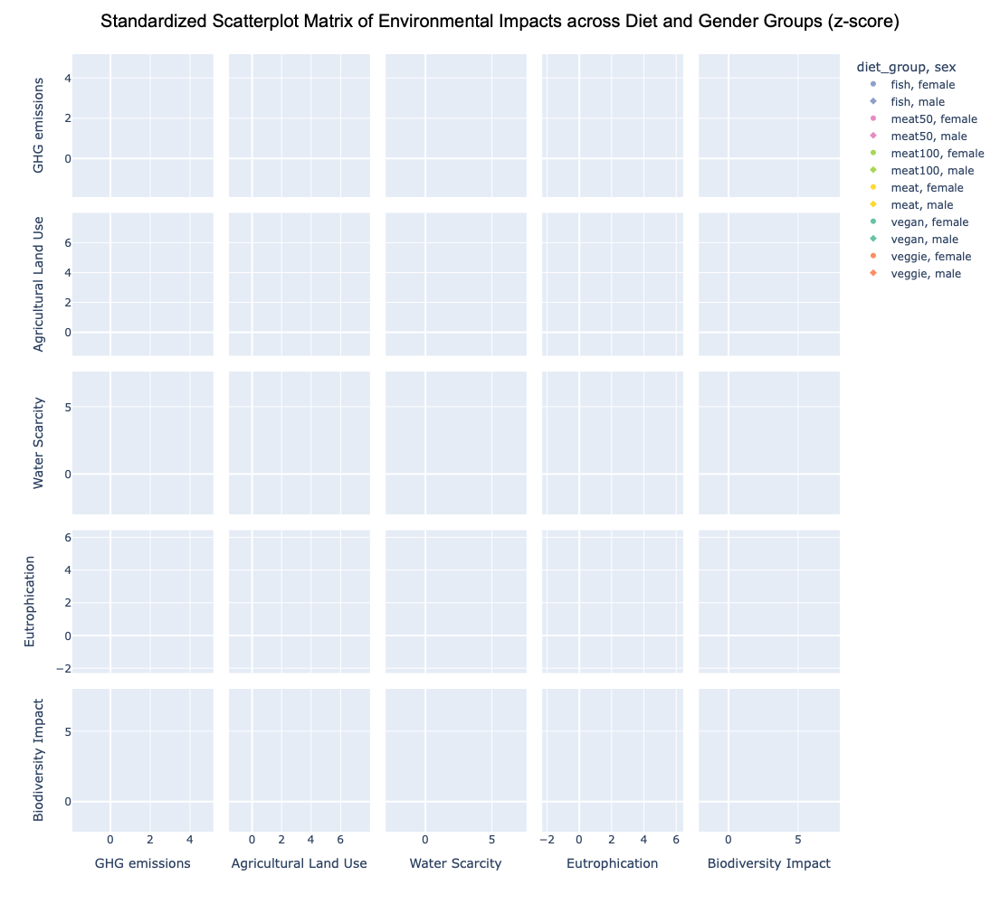

In [21]:
#########################  Standardized Scatterplot Matrix of Environmental Impacts across Diet and Gender Groups (z-score)  ################################

#import pandas as pd
#import plotly.express as px
#from sklearn.preprocessing import StandardScaler

#df = pd.read_csv('Results_21Mar2022.csv')

# 重命名变量列
df = df.rename(columns={
    'mean_ghgs': 'GHG emissions',
    'mean_land': 'Agricultural Land Use',
    'mean_watscar': 'Water Scarcity',
    'mean_eut': 'Eutrophication',
    'mean_bio': 'Biodiversity Impact'
})

# 选择要标准化的列
env_vars = ['GHG emissions', 'Agricultural Land Use', 'Water Scarcity', 'Eutrophication', 'Biodiversity Impact']

# z-score 标准化
scaler = StandardScaler()
df_z = df.copy()
df_z[env_vars] = scaler.fit_transform(df[env_vars])

# ColorBrewer Set2 palette (categorical, colorblind-safe)
color_discrete_map = {
    'vegan': '#66c2a5',
    'veggie': '#fc8d62',
    'fish': '#8da0cb',
    'meat50': '#e78ac3',
    'meat100': '#a6d854',
    'meat': '#ffd92f'
}

# 绘图
fig = px.scatter_matrix(
    df_z,
    dimensions=env_vars,
    color='diet_group',
    symbol='sex',
    color_discrete_map=color_discrete_map,
    hover_data=['age_group']
)

fig.update_layout(
    title='Standardized Scatterplot Matrix of Environmental Impacts across Diet and Gender Groups (z-score)',
    dragmode='select',
    width=1000,
    height=1000,
    title_font=dict(family="Arial", size=20, color="black"),
    title_x=0.5
)

fig.show()

#fig.write_image("/Users/mac/Downloads/Sprng_Smstr/RM/crswrk_2/Scttr_Mtrx_3.svg", scale=1)  # SVG为矢量图 

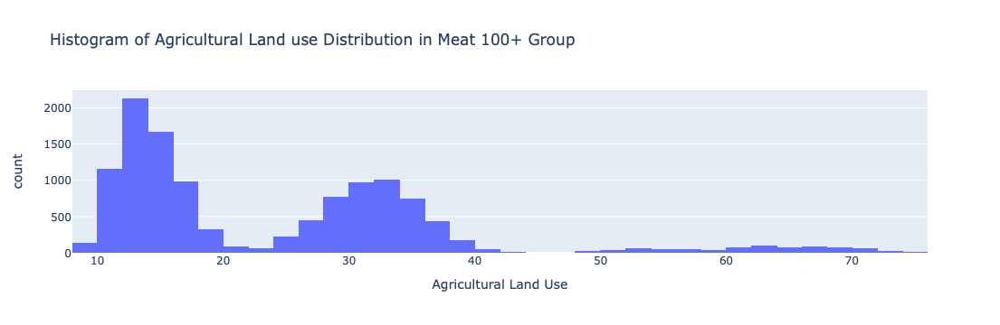

In [8]:
#######################   Histogram of Agricultural Land use Distribution in Meat 100+ Group   ###############################

#import pandas as pd
#import plotly.express as px

#df = pd.read_csv("Results_21Mar2022.csv")

# meat 100+ 组
df_meat100 = df[df['diet_group'] == 'meat100']

# 画 Land use (mean_land) 的分布
fig = px.histogram(df_meat100, x='Agricultural Land Use', nbins=50, 
                   title="Histogram of Agricultural Land use Distribution in Meat 100+ Group")

fig.show()

#fig.write_image("/Users/mac/Downloads/Sprng_Smstr/RM/crswrk_2/hstgrm_0.svg", scale=1)